In [41]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
import os 
import numpy as np

from datetime import datetime
import ccxt
import warnings
warnings.filterwarnings('ignore')

In [6]:
path_perfomers = r'c:\Users\tariq\algorithmic_trading\performers_data'

In [7]:
dataframes = []

for file in os.listdir(path_perfomers):
    if file.endswith('.parquet'): 
        file_path = os.path.join(path_perfomers, file)
        df = pd.read_parquet(file_path)
        
        crypto_name = file.split('_')[0] 
        crypto_name = crypto_name.lower()
        df = df[['date', 'close']].rename(columns={'close': f'{crypto_name}_close'})        
        dataframes.append(df)

In [9]:
big_df = pd.DataFrame()
for df in dataframes:
    if big_df.empty:
        big_df = df
    else:
        big_df = pd.merge(big_df, df, on='date', how='outer')

big_df = big_df.sort_values('date')

In [ ]:
for column in big_df.columns:
    if column.endswith('_close'):
        crypto_name = column.split('_')[0]
        big_df[f'{crypto_name}_ret'] = np.log(big_df[column] / big_df[column].shift(1))
        big_df[f'{crypto_name}_vol'] = big_df[f'{crypto_name}_ret'].rolling(window=20).std()


In [30]:
big_df[["date", "btc_close", "eth_close", "btc_ret", "eth_ret"]] 

,date,btc_close,eth_close,btc_ret,eth_ret
0,2020-01-01 00:00:00,7175.25,128.81,NaN,NaN
1,2020-01-01 00:05:00,7186.69,128.87,0.001593,0.000466
2,2020-01-01 00:10:00,7176.26,128.87,-0.001452,0.000000
3,2020-01-01 00:15:00,7173.68,128.82,-0.000360,-0.000388
4,2020-01-01 00:20:00,7171.81,128.67,-0.000261,-0.001165
...,...,...,...,...,...
624787,2025-03-30 09:50:00,NaN,NaN,NaN,NaN
624788,2025-03-30 09:55:00,NaN,NaN,NaN,NaN
624789,2025-03-30 10:00:00,NaN,NaN,NaN,NaN
624790,2025-03-30 10:05:00,NaN,NaN,NaN,NaN


In [38]:
high_returns_btc = big_df[big_df['btc_ret'] > 0.05]['date']
low_returns_btc = big_df[big_df['btc_ret'] < -0.05]['date']

In [40]:
import plotly.graph_objects as go

fig = go.Figure()
fig.add_trace(go.Scatter(
    x=big_df['date'],
    y=big_df['btc_close'],
    mode='lines',
    name='BTC Close Price',
    line=dict(color='blue')
))

for date in high_returns_btc:
    fig.add_trace(go.Scatter(
        x=[date, date],
        y=[big_df['btc_close'].min(), big_df['btc_close'].max()],
        mode='lines',
        line=dict(color='red', dash='dash'),
        name='BTC Return > 0.05',
        showlegend=False  # Éviter de répéter la légende pour chaque trait
    ))

fig.update_layout(
    title='BTC Price with High Returns Highlighted',
    xaxis_title='Date',
    yaxis_title='BTC Close Price',
    template='plotly_white',
    height=600,
    width=1200,
    #important pour pouvoir zoomer
    dragmode='zoom',  
    xaxis=dict(
        rangeslider=dict(visible=True), 
        title='Date',
        fixedrange=False 
    ),
    yaxis=dict(
        title='BTC Close Price',
        fixedrange=False 
    )
)

fig.show()

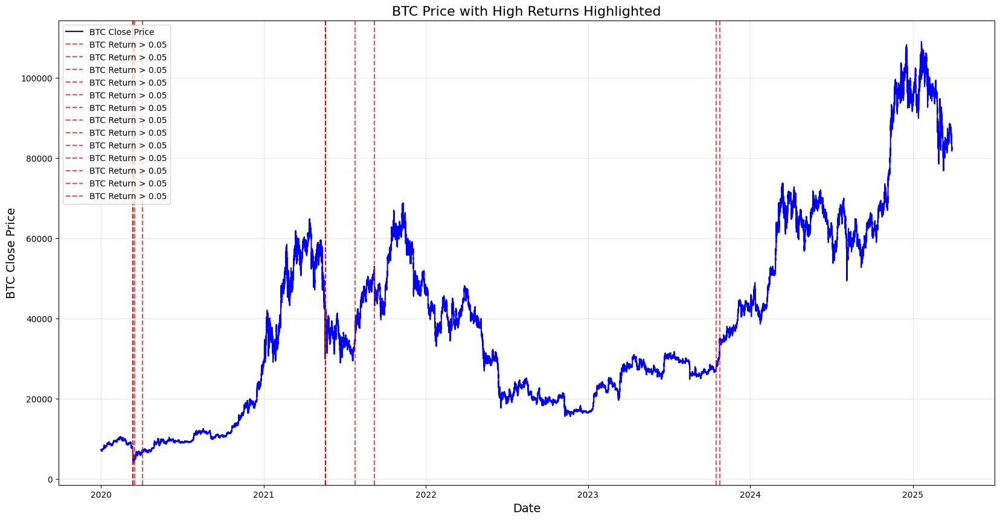

In [34]:
high_returns_btc = big_df[big_df['btc_ret'] > 0.05]['date']
plt.figure(figsize=(20, 10))
plt.plot(big_df['date'], big_df['btc_close'], label='BTC Close Price', color='blue')
for date in high_returns_btc:
    plt.axvline(x=date, color='red', linestyle='--', alpha=0.7, label='BTC Return > 0.05')

plt.title('BTC Price with High Returns Highlighted', fontsize=16)
plt.xlabel('Date', fontsize=14)
plt.ylabel('BTC Close Price', fontsize=14)
plt.legend(loc='upper left')
plt.grid(alpha=0.3)
plt.show()

In [29]:
pd.set_option('display.max_columns', None)  
big_df

,date,1000lunc_close,1000shib_close,1000xec_close,1inch_close,aave_close,ada_close,algo_close,alice_close,alpha_close,ankr_close,ape_close,api3_close,arpa_close,ar_close,ata_close,atom_close,avax_close,axs_close,bake_close,bal_close,band_close,bat_close,bch_close,bel_close,blz_close,bnb_close,btcdom_close,btc_close,c98_close,celo_close,celr_close,chr_close,chz_close,comp_close,coti_close,crv_close,ctk_close,ctsi_close,cvc_close,cvx_close,dar_close,dash_close,defi_close,dent_close,dgb_close,doge_close,dot_close,dusk_close,dydx_close,egld_close,enj_close,ens_close,eos_close,etc_close,eth_close,fil_close,flm_close,flow_close,ftm_close,ftt_close,gala_close,gmt_close,grt_close,gtc_close,hbar_close,hot_close,icx_close,inj_close,iost_close,iota_close,iotx_close,jasmy_close,kava_close,klay_close,knc_close,ksm_close,lina_close,link_close,lit_close,lpt_close,lrc_close,ltc_close,mana_close,mask_close,mkr_close,mtl_close,near_close,neo_close,nkn_close,ocean_close,ogn_close,omg_close,one_close,ont_close,op_close,people_close,qtum_close,ray_close,reef_close,ren_close,rlc_close,rose_close,rsr_close,rune_close,rvn_close,sand_close,sc_close,sfp_close,skl_close,snx_close,sol_close,spell_close,stg_close,stmx_close,storj_close,sushi_close,sxp_close,theta_close,trb_close,trx_close,unfi_close,uni_close,vet_close,waves_close,woo_close,xem_close,xlm_close,xmr_close,xrp_close,xtz_close,yfi_close,zec_close,zen_close,zil_close,zrx_close,1000lunc_ret,1000shib_ret,1000xec_ret,1inch_ret,aave_ret,ada_ret,algo_ret,alice_ret,alpha_ret,ankr_ret,ape_ret,api3_ret,arpa_ret,ar_ret,ata_ret,atom_ret,avax_ret,axs_ret,bake_ret,bal_ret,band_ret,bat_ret,bch_ret,bel_ret,blz_ret,bnb_ret,btcdom_ret,btc_ret,c98_ret,celo_ret,celr_ret,chr_ret,chz_ret,comp_ret,coti_ret,crv_ret,ctk_ret,ctsi_ret,cvc_ret,cvx_ret,dar_ret,dash_ret,defi_ret,dent_ret,dgb_ret,doge_ret,dot_ret,dusk_ret,dydx_ret,egld_ret,enj_ret,ens_ret,eos_ret,etc_ret,eth_ret,fil_ret,flm_ret,flow_ret,ftm_ret,ftt_ret,gala_ret,gmt_ret,grt_ret,gtc_ret,hbar_ret,hot_ret,icx_ret,inj_ret,iost_ret,iota_ret,iotx_ret,jasmy_ret,kava_ret,klay_ret,knc_ret,ksm_ret,lina_ret,link_ret,lit_ret,lpt_ret,lrc_ret,ltc_ret,mana_ret,mask_ret,mkr_ret,mtl_ret,near_ret,neo_ret,nkn_ret,ocean_ret,ogn_ret,omg_ret,one_ret,ont_ret,op_ret,people_ret,qtum_ret,ray_ret,reef_ret,ren_ret,rlc_ret,rose_ret,rsr_ret,rune_ret,rvn_ret,sand_ret,sc_ret,sfp_ret,skl_ret,snx_ret,sol_ret,spell_ret,stg_ret,stmx_ret,storj_ret,sushi_ret,sxp_ret,theta_ret,trb_ret,trx_ret,unfi_ret,uni_ret,vet_ret,waves_ret,woo_ret,xem_ret,xlm_ret,xmr_ret,xrp_ret,xtz_ret,yfi_ret,zec_ret,zen_ret,zil_ret,zrx_ret
0,2020-01-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,203.91,NaN,NaN,NaN,NaN,7175.25,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,128.81,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2020-01-01 00:05:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,204.04,NaN,NaN,NaN,NaN,7186.69,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,128.87,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,

In [18]:
print(5*365*24*12 + 3*30*24*12)

551520


In [10]:
big_df[ (big_df["date"]==datetime(2020,1 1) & (big_df["date"])]

,date,1000lunc_close,1000shib_close,1000xec_close,1inch_close,aave_close,ada_close,algo_close,alice_close,alpha_close,...,xem_close,xlm_close,xmr_close,xrp_close,xtz_close,yfi_close,zec_close,zen_close,zil_close,zrx_close
0,2020-01-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2020-01-01 00:05:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2020-01-01 00:10:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2020-01-01 00:15:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2020-01-01 00:20:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
624787,2025-03-30 09:50:00,0.06051,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
624788,2025-03-30 09:55:00,0.06045,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
624789,2025-03-30 10:00:00,0.06043,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
624790,2025-03-30 10:05:00,0.06045,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


C:\Users\tariq\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\pandas\plotting\_matplotlib\core.py:580: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = self.plt.figure(figsize=self.figsize)


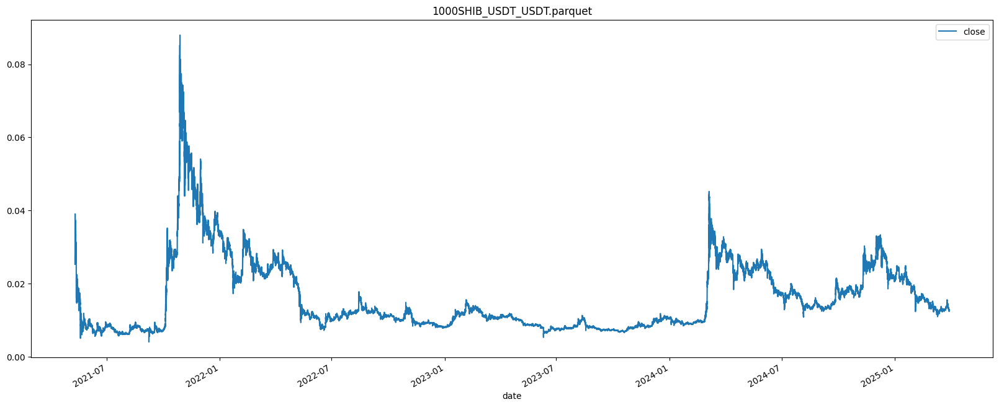

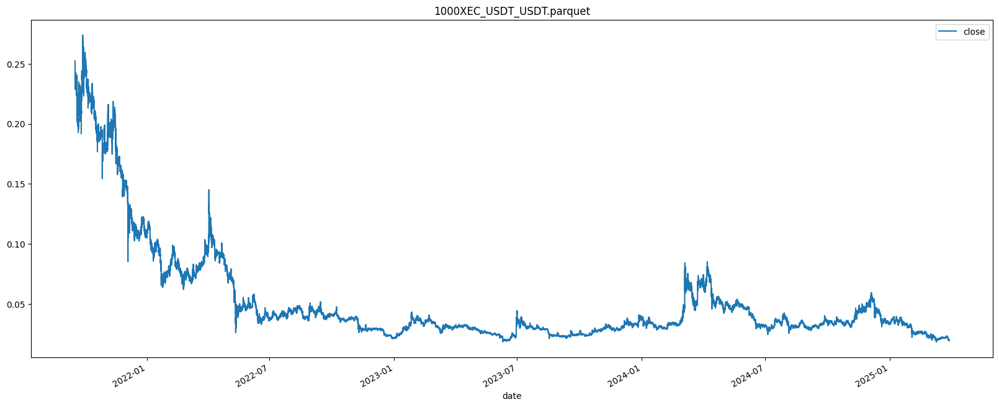

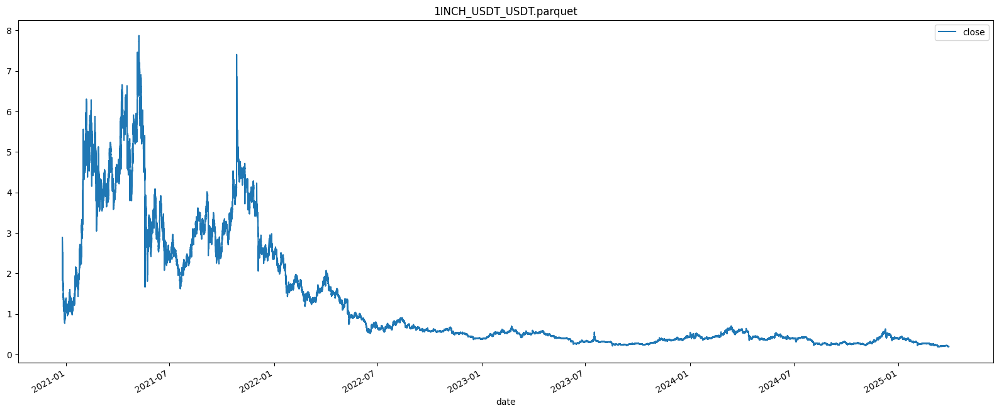

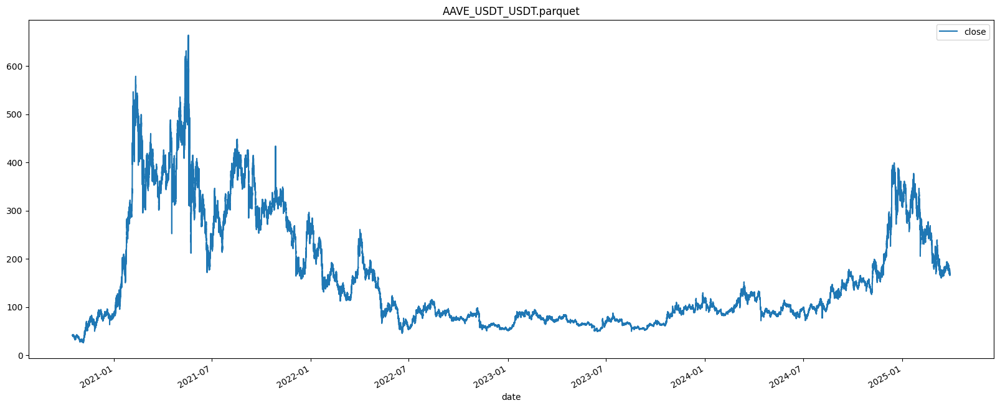

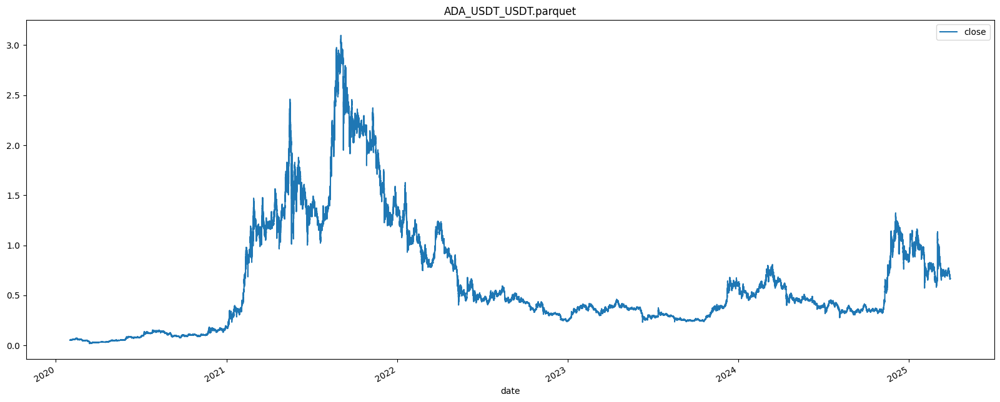

...

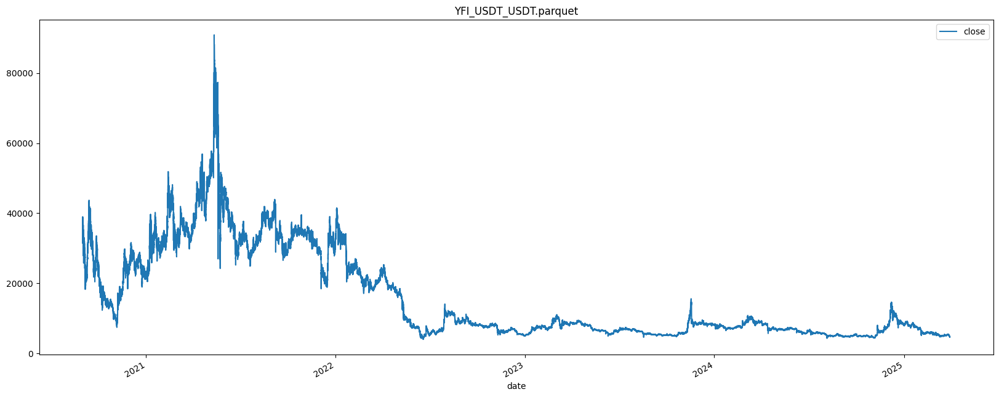

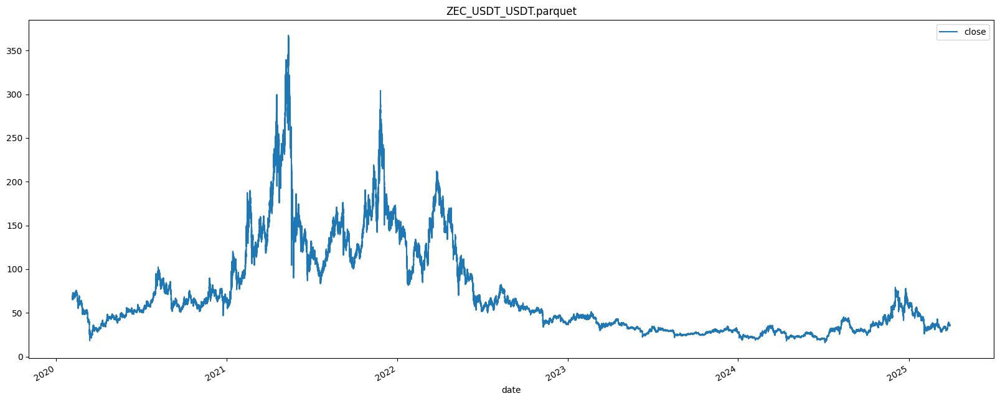

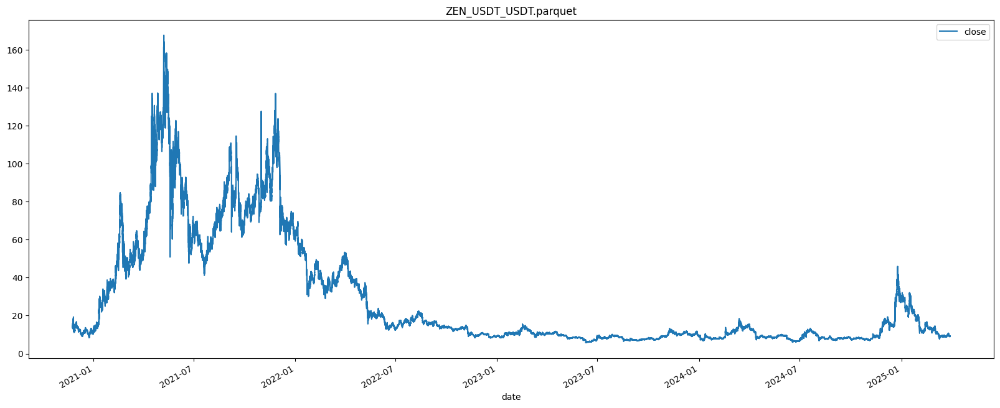

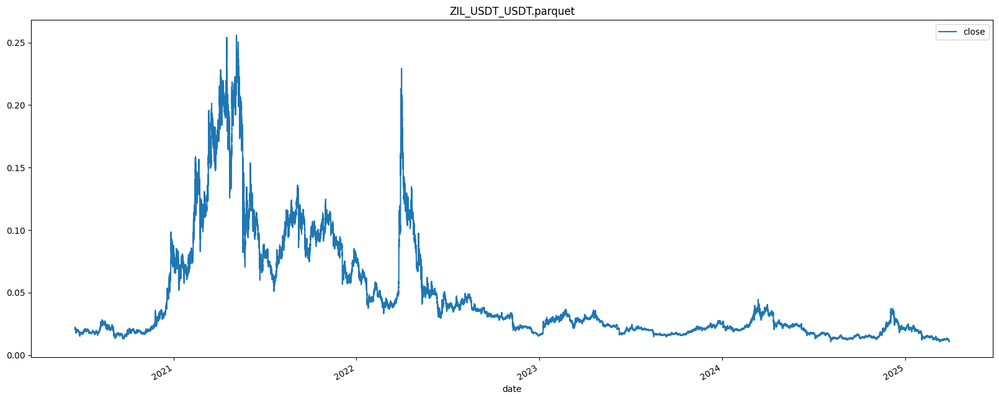

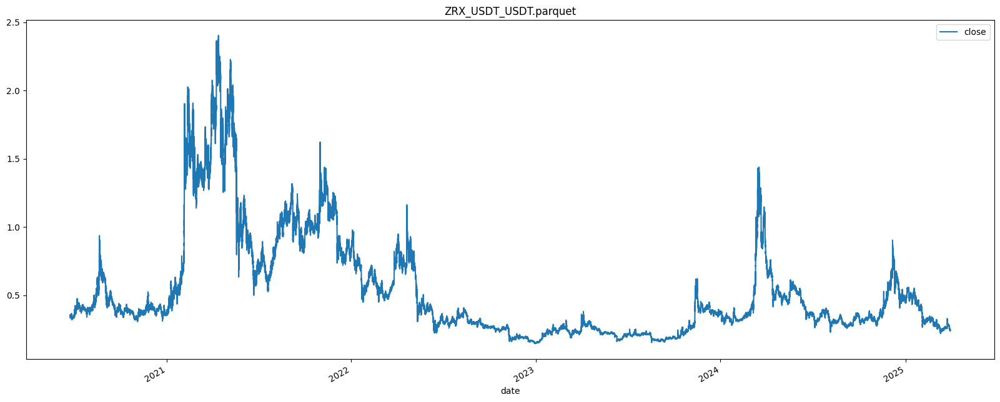

In [2]:
path_perfomers = r'c:\Users\tariq\algorithmic_trading\performers_data'
for file in os.listdir(path_perfomers):
    filepath = os.path.join(path_perfomers, file)
    df = pd.read_parquet(filepath)
    df.plot(x='date', y='close', title=file, figsize=(20, 8))
